## Import libraries -- Years

In [1]:
import pandas as pd
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt
import folium 

In [2]:
from sklearn.neighbors import DistanceMetric

In [3]:
import geohash as gh

## Import dataframes

In [4]:
df = pd.read_csv('../data/master-years.csv')

In [5]:
df.head()

,año_hechos,mes_hechos,fecha_hechos,delito,categoria_delito,fiscalía,agencia,unidad_investigacion,colonia_hechos,alcaldia_hechos,...,mes_inicio,ao_inicio,calle_hechos,calle_hechos2,longitud,latitud,Geopoint,nearest_mb,comp_line,geo_mb
0,2016.0,Enero,2016-01-05 17:00:00,LESIONES CULPOSAS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN GUSTAVO A. MADERO,GAM-6,UI-1CD,GRANJAS MODERNAS,GUSTAVO A MADERO,...,Enero,2016,SAN JUAN DE ARAGON,CALLE ANZAR,-99.103527,19.481076,"19.4810759998,-99.103527",Martín Carrera,[6],"19.4820384425,-99.1053351143"
1,2017.0,Noviembre,2017-11-01 16:40:00,ROBO A TRANSEUNTE EN VIA PUBLICA CON VIOLENCIA,ROBO A TRANSEUNTE EN VÍA PÚBLICA CON Y SIN VIO...,INVESTIGACIÓN EN IZTACALCO,IZC-2,UI-1SD,GABRIEL RAMOS MILLÁN SECCIÓN TLACOTAL,IZTACALCO,...,Noviembre,2017,SUR 117,ORIENTE 100A,-99.106072,19.395398,"19.3953976727,-99.1060723829",Tlacotal,[2],"19.3972441688,-99.1038845531"
2,2018.0,Mayo,2018-05-16 16:00:00,ROBO A REPARTIDOR CON VIOLENCIA,ROBO A REPARTIDOR CON Y SIN VIOLENCIA,INVESTIGACIÓN EN IZTAPALAPA,IZP-9,UI-2SD,DESARROLLO URBANO QUETZALCOATL,IZTAPALAPA,...,Mayo,2018,TARASCO,ZAPOTECO,-99.042786,19.319141,"19.3191405147,-99.0427862526",CCH Oriente,[2],"19.383326965,-99.0607918478"
3,2018.0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-2,UI-2SD,INFONAVIT IZTACALCO,IZTACALCO,...,Mayo,2018,FRANCISCO DEL PASO Y TRONCOSO,ISLA,-99.111563,19.386594,"19.3865939284,-99.1115626682",Colegio de Bachilleres,[5],"19.38632392,-99.1116619153"
4,2016.0,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN IZTACALCO,IZC-1,UI-1CD,LOS REYES,IZTACALCO,...,Enero,2016,AV PLUTARCO ELIAS CALLES,MIRAFUENTES,-99.117183,19.398040,"19.3980399998,-99.117183",Coyuya,[2],"19.3983010647,-99.1167555717"


In [6]:
df.dtypes

año_hechos              float64
mes_hechos               object
fecha_hechos             object
delito                   object
categoria_delito         object
fiscalía                 object
agencia                  object
unidad_investigacion     object
colonia_hechos           object
alcaldia_hechos          object
fecha_inicio             object
mes_inicio               object
ao_inicio                 int64
calle_hechos             object
calle_hechos2            object
longitud                float64
latitud                 float64
Geopoint                 object
nearest_mb               object
comp_line                object
geo_mb                   object
dtype: object

### Handling missing values

In [7]:
df.isna().sum()

año_hechos              0
mes_hechos              0
fecha_hechos            0
delito                  0
categoria_delito        0
fiscalía                0
agencia                 0
unidad_investigacion    0
colonia_hechos          0
alcaldia_hechos         0
fecha_inicio            0
mes_inicio              0
ao_inicio               0
calle_hechos            0
calle_hechos2           0
longitud                0
latitud                 0
Geopoint                0
nearest_mb              0
comp_line               0
geo_mb                  0
dtype: int64

In [8]:
df.shape

(307210, 21)

In [9]:
df['nearest_mb'].value_counts(normalize=True)

Las Bombas                                  0.083793
General Antonio de León                     0.040135
Doctor Gálvez                               0.024635
El Caminero                                 0.022678
Campo Marte                                 0.021279
                                              ...   
MB03-D (La Raza - Tenayuca)                 0.000081
MB06-C (El Rosario - Deportivo 18 Marzo)    0.000078
MB06-C (Deportivo 18 Marzo - El Rosario)    0.000075
Eduardo Molina                              0.000039
MB03-D (Tenayuca - La Raza)                 0.000007
Name: nearest_mb, Length: 290, dtype: float64

In [10]:
len(set(df['nearest_mb']))

290

### EDA on `categoria_delito`

In [11]:
# we want this column to represent 1 if a person suffered from a robbery
# of some sort

len(set(df['categoria_delito']))

16

In [12]:
set(df['categoria_delito'])

{'DELITO DE BAJO IMPACTO',
 'HECHO NO DELICTIVO',
 'HOMICIDIO DOLOSO',
 'LESIONES DOLOSAS POR DISPARO DE ARMA DE FUEGO',
 'ROBO A CASA HABITACIÓN CON VIOLENCIA',
 'ROBO A CUENTAHABIENTE SALIENDO DEL CAJERO CON VIOLENCIA',
 'ROBO A NEGOCIO CON VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE MICROBUS CON Y SIN VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE TAXI CON VIOLENCIA',
 'ROBO A PASAJERO A BORDO DEL METRO CON Y SIN VIOLENCIA',
 'ROBO A REPARTIDOR CON Y SIN VIOLENCIA',
 'ROBO A TRANSEUNTE EN VÍA PÚBLICA CON Y SIN VIOLENCIA',
 'ROBO A TRANSPORTISTA CON Y SIN VIOLENCIA',
 'ROBO DE VEHÍCULO CON Y SIN VIOLENCIA',
 'SECUESTRO',
 'VIOLACIÓN'}

In [13]:
crimes_list = ['DELITO DE BAJO IMPACTO', 'HOMICIDIO DOLOSO',
               'LESIONES DOLOSAS POR DISPARO DE ARMA DE FUEGO', 
               'ROBO A PASAJERO A BORDO DE MICROBUS CON Y SIN VIOLENCIA',
               'ROBO A TRANSEUNTE EN VÍA PÚBLICA CON Y SIN VIOLENCIA']

In [14]:
'''
    Determined that the crimes to target in order to predict a possible 
    incident violent or non violent are going to be:
    - 'DELITO DE BAJO IMPACTO'
    - 'HOMICIDIO DOLOSO'
    - 'ROBO A PASAJERO A BORDO DE MICROBUS CON Y SIN VIOLENCIA'
'''
mb_crimes_filter = ((df['categoria_delito'] == 'DELITO DE BAJO IMPACTO') | (df['categoria_delito'] == 'HOMICIDIO DOLOSO') | \
          (df['categoria_delito'] == 'ROBO A PASAJERO A BORDO DE MICROBUS CON Y SIN VIOLENCIA'))
mb_crimes = df[mb_crimes_filter]

In [15]:
mb_crimes.shape

(233457, 21)

In [16]:
# NOTE!! SETTING:
df = mb_crimes

In [17]:
# Filtering by crime
robberies_crimes = [x for x in list(set(df['delito'])) if x.startswith('ROBO')]

In [18]:
robberies_crimes_filter = df['delito'].isin(robberies_crimes)
robberies_crimes_df = df[robberies_crimes_filter]
df = robberies_crimes_df
df.shape

(111590, 21)

### Binarize column `delito` from `df` dataframe 

In [19]:
def bin_mb(element):
    if element == 'ROBO A PASAJERO A BORDO DE METROBUS SIN VIOLENCIA' or \
    element == 'ROBO A PASAJERO A BORDO DE METROBUS CON VIOLENCIA':
        return 1
    else:
        return 0

In [20]:
df['rob_victim'] = df['delito'].apply(bin_mb)

<ipython-input-20-59787999724f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['rob_victim'] = df['delito'].apply(bin_mb)


In [21]:
df.head(3)

,año_hechos,mes_hechos,fecha_hechos,delito,categoria_delito,fiscalía,agencia,unidad_investigacion,colonia_hechos,alcaldia_hechos,...,ao_inicio,calle_hechos,calle_hechos2,longitud,latitud,Geopoint,nearest_mb,comp_line,geo_mb,rob_victim
3,2018.0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-2,UI-2SD,INFONAVIT IZTACALCO,IZTACALCO,...,2018,FRANCISCO DEL PASO Y TRONCOSO,ISLA,-99.111563,19.386594,"19.3865939284,-99.1115626682",Colegio de Bachilleres,[5],"19.38632392,-99.1116619153",0
4,2016.0,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN IZTACALCO,IZC-1,UI-1CD,LOS REYES,IZTACALCO,...,2016,AV PLUTARCO ELIAS CALLES,MIRAFUENTES,-99.117183,19.398040,"19.3980399998,-99.117183",Coyuya,[2],"19.3983010647,-99.1167555717",0
9,2017.0,Octubre,2017-10-28 20:30:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-6,UI-1SD,NONOALCO TLATELOLCO,CUAUHTEMOC,...,2017,RICARDO FLORES MAGON,EJE CENTRAL LAZARO CARDENAS,-99.138434,19.450030,"19.4500302889,-99.138433644",Glorieta Cuitláhuac,[7],"19.4473766672,-99.1356317535",0


In [22]:
df['rob_victim'].value_counts(normalize=True)

0    0.993225
1    0.006775
Name: rob_victim, dtype: float64

### `fecha_hechos` modification to have just date and create separate time column

In [23]:
def extract_time(element):
    return element.split(' ')[1]

In [24]:
df.columns

Index(['año_hechos', 'mes_hechos', 'fecha_hechos', 'delito',
       'categoria_delito', 'fiscalía', 'agencia', 'unidad_investigacion',
       'colonia_hechos', 'alcaldia_hechos', 'fecha_inicio', 'mes_inicio',
       'ao_inicio', 'calle_hechos', 'calle_hechos2', 'longitud', 'latitud',
       'Geopoint', 'nearest_mb', 'comp_line', 'geo_mb', 'rob_victim'],
      dtype='object')

In [25]:
df['event_time'] = df['fecha_hechos'].apply(lambda x: x.split(' ')[1]).copy()

<ipython-input-25-9cf23ff932d3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['event_time'] = df['fecha_hechos'].apply(lambda x: x.split(' ')[1]).copy()


In [26]:
df['event_date'] = df['fecha_hechos'].apply(lambda x: x.split(' ')[0]).copy()

<ipython-input-26-bd439eefffb0>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['event_date'] = df['fecha_hechos'].apply(lambda x: x.split(' ')[0]).copy()


In [27]:
df.head(1)

,año_hechos,mes_hechos,fecha_hechos,delito,categoria_delito,fiscalía,agencia,unidad_investigacion,colonia_hechos,alcaldia_hechos,...,calle_hechos2,longitud,latitud,Geopoint,nearest_mb,comp_line,geo_mb,rob_victim,event_time,event_date
3,2018.0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-2,UI-2SD,INFONAVIT IZTACALCO,IZTACALCO,...,ISLA,-99.111563,19.386594,"19.3865939284,-99.1115626682",Colegio de Bachilleres,[5],"19.38632392,-99.1116619153",0,20:40:00,2018-05-21


In [28]:
df.columns

Index(['año_hechos', 'mes_hechos', 'fecha_hechos', 'delito',
       'categoria_delito', 'fiscalía', 'agencia', 'unidad_investigacion',
       'colonia_hechos', 'alcaldia_hechos', 'fecha_inicio', 'mes_inicio',
       'ao_inicio', 'calle_hechos', 'calle_hechos2', 'longitud', 'latitud',
       'Geopoint', 'nearest_mb', 'comp_line', 'geo_mb', 'rob_victim',
       'event_time', 'event_date'],
      dtype='object')

### Merge `afluencia-diaria-de-metrobus-cdmx.csv` with df

In [29]:
mb_afl = pd.read_csv('../data/afluencia-diaria-de-metrobus-cdmx-years.csv')
mb_afl.head(1)

,Fecha,Año,Mes,Linea,Afluencia
0,2018-07-08,2018,7,Linea 2,74371


In [30]:
mb_afl.groupby('Linea').mean()

,Año,Mes,Afluencia
Linea,,,
Linea 1,2012.361898,6.646165,318215.858616
Linea 2,2012.361898,6.646165,103697.452653
Linea 3,2012.361898,6.646165,79645.983499
Linea 4,2012.361898,6.646165,28846.374273
Linea 5,2012.361898,6.646165,31536.225014
Linea 6,2012.361898,6.646165,47965.048191
Linea 7,2012.361898,6.646165,13313.876430


In [31]:
mb_afl['Linea'] = mb_afl['Linea'].apply(lambda x: int(x.split(' ')[1]))

In [32]:
df.shape

(111590, 24)

In [33]:
tempor = df.join(mb_afl.set_index('Fecha'), on='event_date')

In [34]:
tempor.columns

Index(['año_hechos', 'mes_hechos', 'fecha_hechos', 'delito',
       'categoria_delito', 'fiscalía', 'agencia', 'unidad_investigacion',
       'colonia_hechos', 'alcaldia_hechos', 'fecha_inicio', 'mes_inicio',
       'ao_inicio', 'calle_hechos', 'calle_hechos2', 'longitud', 'latitud',
       'Geopoint', 'nearest_mb', 'comp_line', 'geo_mb', 'rob_victim',
       'event_time', 'event_date', 'Año', 'Mes', 'Linea', 'Afluencia'],
      dtype='object')

In [35]:
tempor.shape

(781130, 28)

In [36]:
# creating mask for mb lines reduction
mb_mask=[]
for index, row in tempor.iterrows():
    if str(row['Linea']) in row['comp_line']:
        mb_mask.append(True)
    else:
        mb_mask.append(False)

In [37]:
mb_mask[:10]

[False, False, False, False, False, True, False, False, False, True]

In [38]:
temp2 = tempor[mb_mask]
temp2.head(6)

,año_hechos,mes_hechos,fecha_hechos,delito,categoria_delito,fiscalía,agencia,unidad_investigacion,colonia_hechos,alcaldia_hechos,...,nearest_mb,comp_line,geo_mb,rob_victim,event_time,event_date,Año,Mes,Linea,Afluencia
3,2018.0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-2,UI-2SD,INFONAVIT IZTACALCO,IZTACALCO,...,Colegio de Bachilleres,[5],"19.38632392,-99.1116619153",0,20:40:00,2018-05-21,2018,5,5,89793
4,2016.0,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN IZTACALCO,IZC-1,UI-1CD,LOS REYES,IZTACALCO,...,Coyuya,[2],"19.3983010647,-99.1167555717",0,21:20:00,2016-01-02,2016,1,2,76570
9,2017.0,Octubre,2017-10-28 20:30:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-6,UI-1SD,NONOALCO TLATELOLCO,CUAUHTEMOC,...,Glorieta Cuitláhuac,[7],"19.4473766672,-99.1356317535",0,20:30:00,2017-10-28,2017,10,7,0
10,2017.0,Octubre,2017-10-15 12:00:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN VENUSTIANO CARRANZA,VC-1,UI-1SD,MERCED BALBUENA,VENUSTIANO CARRANZA,...,Circunvalación,[4],"19.4283572724,-99.1261902643",0,12:00:00,2017-10-15,2017,10,4,31720
13,2018.0,Mayo,2018-05-13 06:00:00,ROBO DE ACCESORIOS DE AUTO,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN BENITO JUÁREZ,BJ-3,UI-1SD,PIEDAD NARVARTE,BENITO JUAREZ,...,Obrero Mundial,[3],"19.401081165,-99.1555904854",0,06:00:00,2018-05-13,2018,5,3,74753
15,2017.0,Noviembre,2017-11-02 09:30:00,ROBO A NEGOCIO SIN VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN MILPA ALTA,MIL-1,UI-2CD,SAN BARTOLOMÉ XICOMULCO,MILPA ALTA,...,Las Bombas,[5],"19.3118294298,-99.1106325698",0,09:30:00,2017-11-02,2017,11,5,63434


In [39]:
temp3 = temp2.reset_index().drop_duplicates(subset='index', keep='first').set_index('index')
temp3.head(6)

,año_hechos,mes_hechos,fecha_hechos,delito,categoria_delito,fiscalía,agencia,unidad_investigacion,colonia_hechos,alcaldia_hechos,...,nearest_mb,comp_line,geo_mb,rob_victim,event_time,event_date,Año,Mes,Linea,Afluencia
index,,,,,,,,,,,,,,,,,,,,,
3,2018.0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-2,UI-2SD,INFONAVIT IZTACALCO,IZTACALCO,...,Colegio de Bachilleres,[5],"19.38632392,-99.1116619153",0,20:40:00,2018-05-21,2018,5,5,89793
4,2016.0,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN IZTACALCO,IZC-1,UI-1CD,LOS REYES,IZTACALCO,...,Coyuya,[2],"19.3983010647,-99.1167555717",0,21:20:00,2016-01-02,2016,1,2,76570
9,2017.0,Octubre,2017-10-28 20:30:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-6,UI-1SD,NONOALCO TLATELOLCO,CUAUHTEMOC,...,Glorieta Cuitláhuac,[7],"19.4473766672,-99.1356317535",0,20:30:00,2017-10-28,2017,10,7,0
10,2017.0,Octubre,2017-10-15 12:00:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN VENUSTIANO CARRANZA,VC-1,UI-1SD,MERCED BALBUENA,VENUSTIANO CARRANZA,...,Circunvalación,[4],"19.4283572724,-99.1261902643",0,12:00:00,2017-10-15,2017,10,4,31720
13,2018.0,Mayo,2018-05-13 06:00:00,ROBO DE ACCESORIOS DE AUTO,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN BENITO JUÁREZ,BJ-3,UI-1SD,PIEDAD NARVARTE,BENITO JUAREZ,...,Obrero Mundial,[3],"19.401081165,-99.1555904854",0,06:00:00,2018-05-13,2018,5,3,74753
15,2017.0,Noviembre,2017-11-02 09:30:00,ROBO A NEGOCIO SIN VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN MILPA ALTA,MIL-1,UI-2CD,SAN BARTOLOMÉ XICOMULCO,MILPA ALTA,...,Las Bombas,[5],"19.3118294298,-99.1106325698",0,09:30:00,2017-11-02,2017,11,5,63434


In [40]:
temp3.reset_index(drop=True, inplace=True)
temp3.head(3)

,año_hechos,mes_hechos,fecha_hechos,delito,categoria_delito,fiscalía,agencia,unidad_investigacion,colonia_hechos,alcaldia_hechos,...,nearest_mb,comp_line,geo_mb,rob_victim,event_time,event_date,Año,Mes,Linea,Afluencia
0,2018.0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-2,UI-2SD,INFONAVIT IZTACALCO,IZTACALCO,...,Colegio de Bachilleres,[5],"19.38632392,-99.1116619153",0,20:40:00,2018-05-21,2018,5,5,89793
1,2016.0,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN IZTACALCO,IZC-1,UI-1CD,LOS REYES,IZTACALCO,...,Coyuya,[2],"19.3983010647,-99.1167555717",0,21:20:00,2016-01-02,2016,1,2,76570
2,2017.0,Octubre,2017-10-28 20:30:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-6,UI-1SD,NONOALCO TLATELOLCO,CUAUHTEMOC,...,Glorieta Cuitláhuac,[7],"19.4473766672,-99.1356317535",0,20:30:00,2017-10-28,2017,10,7,0


In [41]:
temp3.isna().sum()

año_hechos              0
mes_hechos              0
fecha_hechos            0
delito                  0
categoria_delito        0
fiscalía                0
agencia                 0
unidad_investigacion    0
colonia_hechos          0
alcaldia_hechos         0
fecha_inicio            0
mes_inicio              0
ao_inicio               0
calle_hechos            0
calle_hechos2           0
longitud                0
latitud                 0
Geopoint                0
nearest_mb              0
comp_line               0
geo_mb                  0
rob_victim              0
event_time              0
event_date              0
Año                     0
Mes                     0
Linea                   0
Afluencia               0
dtype: int64

In [42]:
set(temp3['mes_hechos'])

{'Abril',
 'Agosto',
 'Diciembre',
 'Enero',
 'Febrero',
 'Julio',
 'Junio',
 'Marzo',
 'Mayo',
 'Noviembre',
 'Octubre',
 'Septiembre'}

In [43]:
set(temp3['delito'])

{'ROBO A CASA HABITACION SIN VIOLENCIA',
 'ROBO A CASA HABITACION Y VEHICULO SIN VIOLENCIA',
 'ROBO A NEGOCIO SIN VIOLENCIA',
 'ROBO A NEGOCIO Y VEHICULO SIN VIOLENCIA',
 'ROBO A OFICINA PÚBLICA SIN VIOLENCIA',
 'ROBO A PASAJERO / CONDUCTOR DE TAXI CON VIOLENCIA',
 'ROBO A PASAJERO / CONDUCTOR DE VEHICULO CON VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE METROBUS CON VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE METROBUS SIN VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE PESERO COLECTIVO CON VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE PESERO COLECTIVO SIN VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE PESERO Y VEHICULO CON VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE TAXI SIN VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE TRANSPORTE PÚBLICO CON VIOLENCIA',
 'ROBO A PASAJERO A BORDO DE TRANSPORTE PÚBLICO SIN VIOLENCIA',
 'ROBO A PASAJERO EN AUTOBUS FORANEO SIN VIOLENCIA',
 'ROBO A PASAJERO EN AUTOBÚS FORÁNEO CON VIOLENCIA',
 'ROBO A PASAJERO EN ECOBUS CON VIOLENCIA',
 'ROBO A PASAJERO EN ECOBUS SIN VIOLENCIA',
 'ROBO A P

In [44]:
def trans_crime(element):
    target_crimes = ['ROBO A TRANSEUNTE EN VIA PUBLICA CON VIOLENCIA', 
                      'ROBO A TRANSEUNTE EN VIA PUBLICA SIN VIOLENCIA',
                      'ROBO A PASAJERO A BORDO DE METROBUS CON VIOLENCIA',
                      'ROBO A PASAJERO A BORDO DE METROBUS SIN VIOLENCIA',
                    'ROBO A PASAJERO A BORDO DE TRANSPORTE PÚBLICO CON VIOLENCIA']

    if element in target_crimes:
        return 1
    else:
        return 0

In [45]:
temp3['target_crimes'] = temp3['delito'].apply(trans_crime)

In [46]:
temp3['target_crimes'].value_counts(normalize=True)

0    0.976951
1    0.023049
Name: target_crimes, dtype: float64

#### Feature egineering: Harvesine distance

In [47]:
# Function taken from following reference [URL]: https://towardsdatascience.com/heres-how-to-calculate-distance-between-2-geolocations-in-python-93ecab5bbba4
def haversine_distance(geo_one, geo_two):
    g1 = geo_one.split(',')
    g2 = geo_two.split(',')
    lat1 = float(g1[0])
    lat2 = float(g2[0])
    lon1 = float(g1[1])
    lon2 = float(g2[1])
    r = 6371
    phi1 = np.radians(lat1)
    phi2 = np.radians(lat2)
    delta_phi = np.radians(lat2 - lat1)
    delta_lambda = np.radians(lon2 - lon1)
    a = np.sin(delta_phi / 2)**2 + np.cos(phi1) * np.cos(phi2) *   np.sin(delta_lambda / 2)**2
    res = r * (2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a)))
    return np.round(res, 2)

In [48]:
temp3[['Geopoint', 'geo_mb']].head(1)

,Geopoint,geo_mb
0,"19.3865939284,-99.1115626682","19.38632392,-99.1116619153"


In [49]:
temp3['Geopoint'].iloc[[0]][0]

'19.3865939284,-99.1115626682'

In [50]:
haversine_distance(temp3['Geopoint'].iloc[[0]][0], temp3['geo_mb'].iloc[[0]][0])

0.03

In [51]:
distance_km=[]
for index, row in temp3.iterrows():
    distance_km.append(haversine_distance(row['Geopoint'], row['geo_mb']))

In [52]:
d = {'dist_km': np.array(distance_km)}
d_geos = pd.DataFrame(data=d)
d_geos.head()

,dist_km
0,0.03
1,0.05
2,0.42
3,0.13
4,0.42


In [53]:
temp3.shape

(111590, 29)

In [54]:
master_df = pd.concat([temp3, d_geos], axis=1)
master_df.head(3)

,año_hechos,mes_hechos,fecha_hechos,delito,categoria_delito,fiscalía,agencia,unidad_investigacion,colonia_hechos,alcaldia_hechos,...,geo_mb,rob_victim,event_time,event_date,Año,Mes,Linea,Afluencia,target_crimes,dist_km
0,2018.0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-2,UI-2SD,INFONAVIT IZTACALCO,IZTACALCO,...,"19.38632392,-99.1116619153",0,20:40:00,2018-05-21,2018,5,5,89793,0,0.03
1,2016.0,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN IZTACALCO,IZC-1,UI-1CD,LOS REYES,IZTACALCO,...,"19.3983010647,-99.1167555717",0,21:20:00,2016-01-02,2016,1,2,76570,0,0.05
2,2017.0,Octubre,2017-10-28 20:30:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,INVESTIGACIÓN EN CUAUHTEMOC,CUH-6,UI-1SD,NONOALCO TLATELOLCO,CUAUHTEMOC,...,"19.4473766672,-99.1356317535",0,20:30:00,2017-10-28,2017,10,7,0,0,0.42


In [55]:
master_df['dist_km'].describe()

count    111590.000000
mean          1.872496
std           2.393246
min           0.000000
25%           0.330000
50%           0.960000
75%           2.530000
max          19.840000
Name: dist_km, dtype: float64

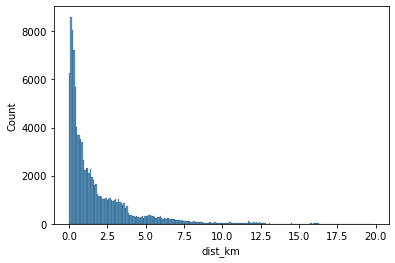

In [56]:
sns.histplot(master_df['dist_km'])

In [57]:
# Setting 1 km as threshold for max distance from event of crime and MB
master_df['dist_km'] = master_df['dist_km'].apply(lambda x: x if x <= .3 else None)

In [58]:
master_df.isna().sum()

año_hechos                  0
mes_hechos                  0
fecha_hechos                0
delito                      0
categoria_delito            0
fiscalía                    0
agencia                     0
unidad_investigacion        0
colonia_hechos              0
alcaldia_hechos             0
fecha_inicio                0
mes_inicio                  0
ao_inicio                   0
calle_hechos                0
calle_hechos2               0
longitud                    0
latitud                     0
Geopoint                    0
nearest_mb                  0
comp_line                   0
geo_mb                      0
rob_victim                  0
event_time                  0
event_date                  0
Año                         0
Mes                         0
Linea                       0
Afluencia                   0
target_crimes               0
dist_km                 86004
dtype: int64

In [59]:
master_df = master_df.dropna()
master_df.shape

(25586, 30)

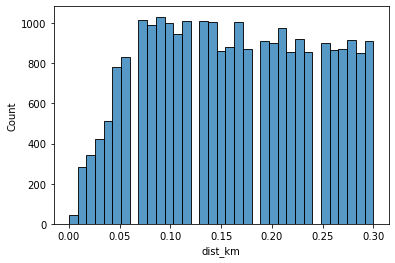

In [60]:
sns.histplot(master_df['dist_km'])

In [61]:
master_df.columns

Index(['año_hechos', 'mes_hechos', 'fecha_hechos', 'delito',
       'categoria_delito', 'fiscalía', 'agencia', 'unidad_investigacion',
       'colonia_hechos', 'alcaldia_hechos', 'fecha_inicio', 'mes_inicio',
       'ao_inicio', 'calle_hechos', 'calle_hechos2', 'longitud', 'latitud',
       'Geopoint', 'nearest_mb', 'comp_line', 'geo_mb', 'rob_victim',
       'event_time', 'event_date', 'Año', 'Mes', 'Linea', 'Afluencia',
       'target_crimes', 'dist_km'],
      dtype='object')

In [62]:
master_df.dtypes

año_hechos              float64
mes_hechos               object
fecha_hechos             object
delito                   object
categoria_delito         object
fiscalía                 object
agencia                  object
unidad_investigacion     object
colonia_hechos           object
alcaldia_hechos          object
fecha_inicio             object
mes_inicio               object
ao_inicio                 int64
calle_hechos             object
calle_hechos2            object
longitud                float64
latitud                 float64
Geopoint                 object
nearest_mb               object
comp_line                object
geo_mb                   object
rob_victim                int64
event_time               object
event_date               object
Año                       int64
Mes                       int64
Linea                     int64
Afluencia                 int64
target_crimes             int64
dist_km                 float64
dtype: object

### EDA on master dataframe

In [63]:
from folium import plugins

In [64]:
lat_cdmx = 19.432608
lon_cdmx = -99.133209

# let's start again with a clean copy of the map of San Francisco
cdmx_map=folium.Map(
    location=[lat_cdmx, lon_cdmx],
    zoom_start=12
)

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(cdmx_map)

# loop through the dataframe and add each data point to the mark cluster
for lat, lon, label in zip(master_df['latitud'], master_df['longitud'], master_df['delito']):
    folium.Marker(
        location=[lat, lon],
        popup=label,
        icon=None
    ).add_to(incidents)

# display map
cdmx_map

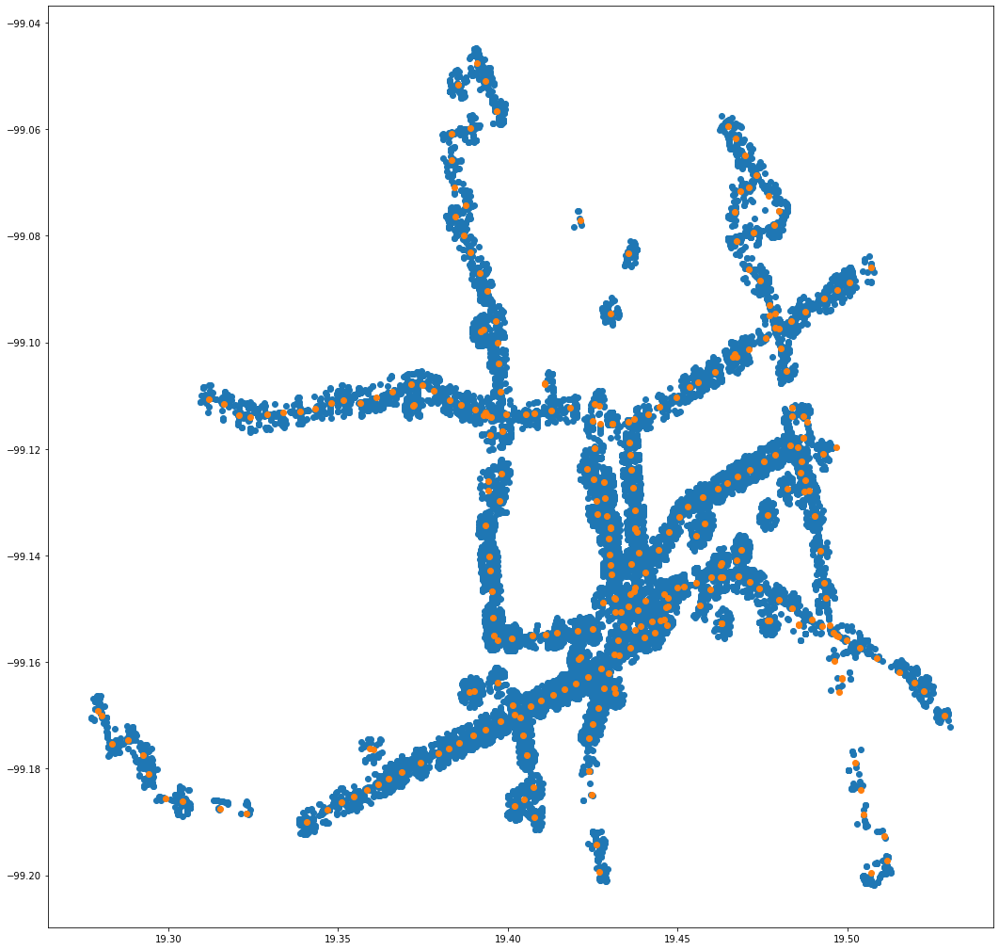

In [65]:
stations_mb = pd.read_csv('../data/estaciones-metrobus0.csv')
stations_mb['lat'] = stations_mb['Geo Point'].apply(lambda x: float(x.split(',')[0]))
stations_mb['long'] = stations_mb['Geo Point'].apply(lambda x: float(x.split(',')[1]))

fig, ax = plt.subplots(figsize=(18,18))
ax.scatter(master_df['latitud'], master_df['longitud'])
ax.scatter(stations_mb['lat'], stations_mb['long']);

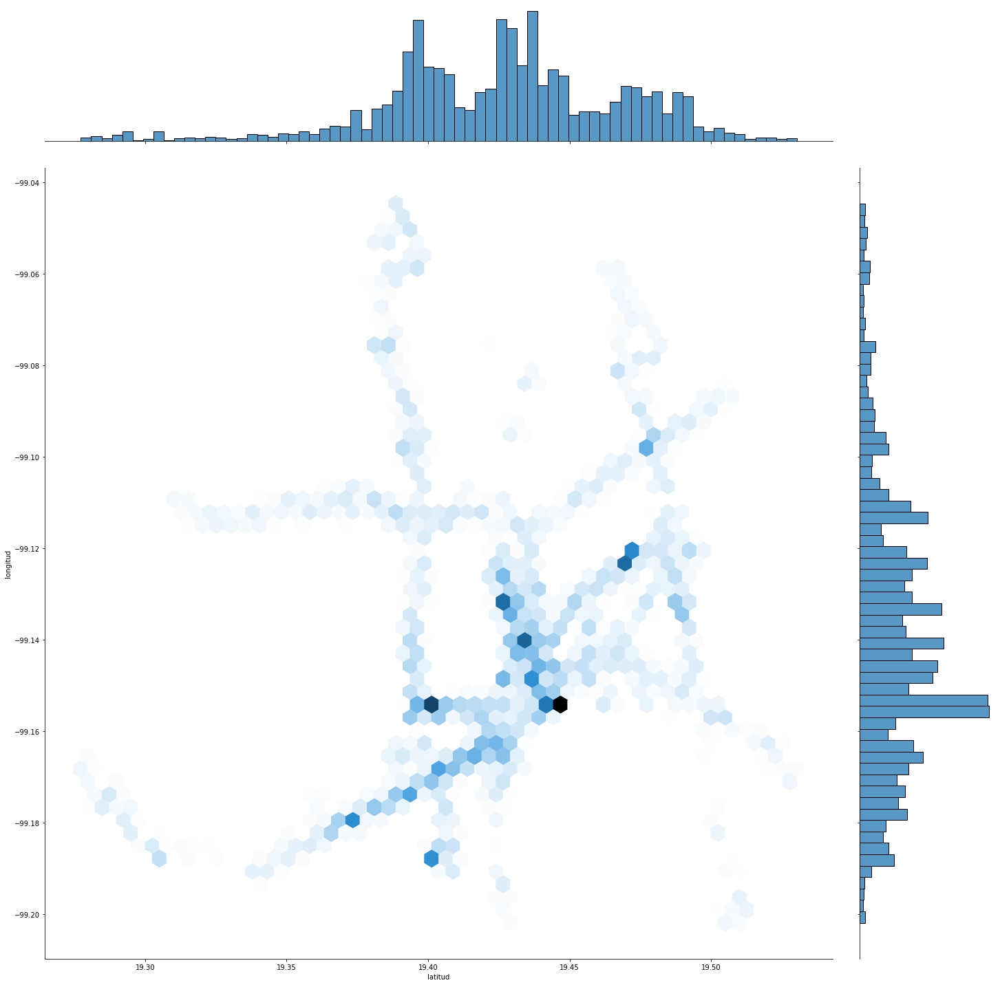

In [66]:
sns.jointplot(data=master_df, x='latitud', y='longitud', kind='hex', height=20 );

In [67]:
master_df.columns

Index(['año_hechos', 'mes_hechos', 'fecha_hechos', 'delito',
       'categoria_delito', 'fiscalía', 'agencia', 'unidad_investigacion',
       'colonia_hechos', 'alcaldia_hechos', 'fecha_inicio', 'mes_inicio',
       'ao_inicio', 'calle_hechos', 'calle_hechos2', 'longitud', 'latitud',
       'Geopoint', 'nearest_mb', 'comp_line', 'geo_mb', 'rob_victim',
       'event_time', 'event_date', 'Año', 'Mes', 'Linea', 'Afluencia',
       'target_crimes', 'dist_km'],
      dtype='object')

In [68]:
master_df.dtypes

año_hechos              float64
mes_hechos               object
fecha_hechos             object
delito                   object
categoria_delito         object
fiscalía                 object
agencia                  object
unidad_investigacion     object
colonia_hechos           object
alcaldia_hechos          object
fecha_inicio             object
mes_inicio               object
ao_inicio                 int64
calle_hechos             object
calle_hechos2            object
longitud                float64
latitud                 float64
Geopoint                 object
nearest_mb               object
comp_line                object
geo_mb                   object
rob_victim                int64
event_time               object
event_date               object
Año                       int64
Mes                       int64
Linea                     int64
Afluencia                 int64
target_crimes             int64
dist_km                 float64
dtype: object

### Dropping columns with no relevance

In [69]:
drop_cols = ['fiscalía', 'agencia', 'unidad_investigacion', 
             'Año', 'Mes', 'año_hechos', 'comp_line', 'mes_inicio',
             'calle_hechos2', 'ao_inicio']
master_df = master_df.drop(columns=drop_cols)

In [70]:
master_df.columns

Index(['mes_hechos', 'fecha_hechos', 'delito', 'categoria_delito',
       'colonia_hechos', 'alcaldia_hechos', 'fecha_inicio', 'calle_hechos',
       'longitud', 'latitud', 'Geopoint', 'nearest_mb', 'geo_mb', 'rob_victim',
       'event_time', 'event_date', 'Linea', 'Afluencia', 'target_crimes',
       'dist_km'],
      dtype='object')

In [71]:
master_df.isna().sum()

mes_hechos          0
fecha_hechos        0
delito              0
categoria_delito    0
colonia_hechos      0
alcaldia_hechos     0
fecha_inicio        0
calle_hechos        0
longitud            0
latitud             0
Geopoint            0
nearest_mb          0
geo_mb              0
rob_victim          0
event_time          0
event_date          0
Linea               0
Afluencia           0
target_crimes       0
dist_km             0
dtype: int64

## Feature Engineering: Manhattan Distance


In [72]:
master_df.columns

Index(['mes_hechos', 'fecha_hechos', 'delito', 'categoria_delito',
       'colonia_hechos', 'alcaldia_hechos', 'fecha_inicio', 'calle_hechos',
       'longitud', 'latitud', 'Geopoint', 'nearest_mb', 'geo_mb', 'rob_victim',
       'event_time', 'event_date', 'Linea', 'Afluencia', 'target_crimes',
       'dist_km'],
      dtype='object')

In [73]:
# Function taken from following reference[URL]: https://maney020.medium.com/feature-engineering-all-i-learned-about-geo-spatial-features-649871d16796
def haversine_dist(lat1,lng1,lat2,lng2):
    lat1, lng1, lat2, lng2 = map(np.radians, (lat1, lng1, lat2, lng2))
    radius = 6371  # Earth's radius taken from google
    lat = lat2 - lat1
    lng = lng2 - lng1
    d = np.sin(lat/2) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(lng/2) ** 2
    h = 2 * radius * np.arcsin(np.sqrt(d))
    return h


def manhattan_dist(geo_one, geo_two):
    '''
    calculating two haversine distances by,
     - avoiding Latitude of one point 
     - avoiding Longitude of one point
    and adding it together.
    '''
    g1 = geo_one.split(',')
    g2 = geo_two.split(',')
    lat1 = float(g1[0])
    lat2 = float(g2[0])
    lng1 = float(g1[1])
    lng2 = float(g2[1])
    a = haversine_dist(lat1, lng1, lat1, lng2)
    b = haversine_dist(lat1, lng1, lat2, lng1)
    return a + b

In [74]:
manhattan_list=[]
for index, row in master_df.iterrows():
    manhattan_list.append(manhattan_dist(row['Geopoint'], row['geo_mb']))

d = {'manhattan_dist': np.array(manhattan_list)}
d_geos = pd.DataFrame(data=d)
d_geos.head()

,manhattan_dist
0,0.040434
1,0.073859
2,0.134643
3,0.073419
4,0.114954


In [75]:
d_geos.shape

(25586, 1)

In [76]:
master_df.head(3)

,mes_hechos,fecha_hechos,delito,categoria_delito,colonia_hechos,alcaldia_hechos,fecha_inicio,calle_hechos,longitud,latitud,Geopoint,nearest_mb,geo_mb,rob_victim,event_time,event_date,Linea,Afluencia,target_crimes,dist_km
0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INFONAVIT IZTACALCO,IZTACALCO,2018-05-22 10:52:18,FRANCISCO DEL PASO Y TRONCOSO,-99.111563,19.386594,"19.3865939284,-99.1115626682",Colegio de Bachilleres,"19.38632392,-99.1116619153",0,20:40:00,2018-05-21,5,89793,0,0.03
1,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,LOS REYES,IZTACALCO,2016-01-05 19:37:09,AV PLUTARCO ELIAS CALLES,-99.117183,19.398040,"19.3980399998,-99.117183",Coyuya,"19.3983010647,-99.1167555717",0,21:20:00,2016-01-02,2,76570,0,0.05
3,Octubre,2017-10-15 12:00:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,MERCED BALBUENA,VENUSTIANO CARRANZA,2017-11-01 22:12:42,ANILLO DE CIRCUNVALACION,-99.124966,19.428301,"19.4283013376,-99.1249655939",Circunvalación,"19.4283572724,-99.1261902643",0,12:00:00,2017-10-15,4,31720,0,0.13


In [77]:
#resetting index for joining dataframe
master_df.reset_index(drop=True, inplace=True)
master_df = pd.concat([master_df, d_geos], axis=1)
master_df.head(3)

,mes_hechos,fecha_hechos,delito,categoria_delito,colonia_hechos,alcaldia_hechos,fecha_inicio,calle_hechos,longitud,latitud,...,nearest_mb,geo_mb,rob_victim,event_time,event_date,Linea,Afluencia,target_crimes,dist_km,manhattan_dist
0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INFONAVIT IZTACALCO,IZTACALCO,2018-05-22 10:52:18,FRANCISCO DEL PASO Y TRONCOSO,-99.111563,19.386594,...,Colegio de Bachilleres,"19.38632392,-99.1116619153",0,20:40:00,2018-05-21,5,89793,0,0.03,0.040434
1,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,LOS REYES,IZTACALCO,2016-01-05 19:37:09,AV PLUTARCO ELIAS CALLES,-99.117183,19.398040,...,Coyuya,"19.3983010647,-99.1167555717",0,21:20:00,2016-01-02,2,76570,0,0.05,0.073859
2,Octubre,2017-10-15 12:00:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,MERCED BALBUENA,VENUSTIANO CARRANZA,2017-11-01 22:12:42,ANILLO DE CIRCUNVALACION,-99.124966,19.428301,...,Circunvalación,"19.4283572724,-99.1261902643",0,12:00:00,2017-10-15,4,31720,0,0.13,0.134643


In [78]:
master_df.shape

(25586, 21)

### Feature Engineering: Bearing Between the two Lat/Lons

In [79]:
def bearing_array(geo_one, geo_two):
    g1 = geo_one.split(',')
    g2 = geo_two.split(',')
    lat1 = float(g1[0])
    lat2 = float(g2[0])
    lng1 = float(g1[1])
    lng2 = float(g2[1])
    AVG_EARTH_RADIUS = 6371  # in km
    lng_delta_rad = np.radians(lng2 - lng1)
    lat1, lng1, lat2, lng2 = map(np.radians, (lat1, lng1, lat2, lng2))
    y = np.sin(lng_delta_rad) * np.cos(lat2)
    x = np.cos(lat1) * np.sin(lat2) - np.sin(lat1) * np.cos(lat2) * np.cos(lng_delta_rad)
    return np.degrees(np.arctan2(y, x))

In [80]:
bearing_list=[]
for index, row in master_df.iterrows():
    bearing_list.append(bearing_array(row['Geopoint'], row['geo_mb']))

d = {'bearing': np.array(bearing_list)}
d_geos = pd.DataFrame(data=d)
d_geos.head()

,bearing
0,-160.877039
1,57.075287
2,-87.227065
3,86.538143
4,119.076513


In [81]:
#resetting index for joining dataframe
master_df.reset_index(drop=True, inplace=True)
master_df = pd.concat([master_df, d_geos], axis=1)
master_df.head(3)

,mes_hechos,fecha_hechos,delito,categoria_delito,colonia_hechos,alcaldia_hechos,fecha_inicio,calle_hechos,longitud,latitud,...,geo_mb,rob_victim,event_time,event_date,Linea,Afluencia,target_crimes,dist_km,manhattan_dist,bearing
0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INFONAVIT IZTACALCO,IZTACALCO,2018-05-22 10:52:18,FRANCISCO DEL PASO Y TRONCOSO,-99.111563,19.386594,...,"19.38632392,-99.1116619153",0,20:40:00,2018-05-21,5,89793,0,0.03,0.040434,-160.877039
1,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,LOS REYES,IZTACALCO,2016-01-05 19:37:09,AV PLUTARCO ELIAS CALLES,-99.117183,19.398040,...,"19.3983010647,-99.1167555717",0,21:20:00,2016-01-02,2,76570,0,0.05,0.073859,57.075287
2,Octubre,2017-10-15 12:00:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,MERCED BALBUENA,VENUSTIANO CARRANZA,2017-11-01 22:12:42,ANILLO DE CIRCUNVALACION,-99.124966,19.428301,...,"19.4283572724,-99.1261902643",0,12:00:00,2017-10-15,4,31720,0,0.13,0.134643,-87.227065


#### `fecha_hechos` to datetime

In [82]:
master_df['fecha_hechos'] = pd.to_datetime(master_df['fecha_hechos'])

### Feature Engineering: GeoHash on crime location

In [83]:
def geohash(geo_loc, precision=8):
    '''
        input: dataframe containing Latitude(x) and Longitude(y)
        output: List of numbers corresponding to their allocated buckets.
    '''
    g1 = geo_loc.split(',')
    lat1 = float(g1[0])
    lng1 = float(g1[1])
    enc_coords = gh.encode(lat1,lng1, precision)
    return enc_coords

In [84]:
geohash(master_df['Geopoint'].iloc[[0]][0])

'9g3w29jp'

In [85]:
geohash(master_df['Geopoint'].iloc[[2]][2])

'9g3w82g6'

In [86]:
master_df['Geopoint'].iloc[[2]][2]

'19.4283013376,-99.1249655939'

In [87]:
master_df['geo_hash_crime'] = master_df['Geopoint'].apply(geohash)

### Feature Engineering: GeoHash on mb_station

In [88]:
master_df['geo_hash_mb'] = master_df['geo_mb'].apply(geohash)

In [89]:
master_df.shape

(25586, 24)

In [90]:
master_df.columns

Index(['mes_hechos', 'fecha_hechos', 'delito', 'categoria_delito',
       'colonia_hechos', 'alcaldia_hechos', 'fecha_inicio', 'calle_hechos',
       'longitud', 'latitud', 'Geopoint', 'nearest_mb', 'geo_mb', 'rob_victim',
       'event_time', 'event_date', 'Linea', 'Afluencia', 'target_crimes',
       'dist_km', 'manhattan_dist', 'bearing', 'geo_hash_crime',
       'geo_hash_mb'],
      dtype='object')

In [91]:
master_df.head(4)

,mes_hechos,fecha_hechos,delito,categoria_delito,colonia_hechos,alcaldia_hechos,fecha_inicio,calle_hechos,longitud,latitud,...,event_time,event_date,Linea,Afluencia,target_crimes,dist_km,manhattan_dist,bearing,geo_hash_crime,geo_hash_mb
0,Mayo,2018-05-21 20:40:00,ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA,DELITO DE BAJO IMPACTO,INFONAVIT IZTACALCO,IZTACALCO,2018-05-22 10:52:18,FRANCISCO DEL PASO Y TRONCOSO,-99.111563,19.386594,...,20:40:00,2018-05-21,5,89793,0,0.03,0.040434,-160.877039,9g3w29jp,9g3w29jj
1,Enero,2016-01-02 21:20:00,ROBO DE DINERO,DELITO DE BAJO IMPACTO,LOS REYES,IZTACALCO,2016-01-05 19:37:09,AV PLUTARCO ELIAS CALLES,-99.117183,19.398040,...,21:20:00,2016-01-02,2,76570,0,0.05,0.073859,57.075287,9g3w2e31,9g3w2e37
2,Octubre,2017-10-15 12:00:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,MERCED BALBUENA,VENUSTIANO CARRANZA,2017-11-01 22:12:42,ANILLO DE CIRCUNVALACION,-99.124966,19.428301,...,12:00:00,2017-10-15,4,31720,0,0.13,0.134643,-87.227065,9g3w82g6,9g3w82fd
3,Enero,2016-01-11 21:00:00,ROBO DE OBJETOS,DELITO DE BAJO IMPACTO,ESCANDÓN I SECCIÓN,MIGUEL HIDALGO,2016-01-16 18:09:10,AV. PATRIOTISMO,-99.178065,19.405499,...,21:00:00,2016-01-11,2,173477,0,0.07,0.073419,86.538143,9g3qrhst,9g3qrhtj


In [92]:
len(set(master_df['geo_hash_crime']))

11772

In [93]:
len(set(master_df['geo_hash_mb']))

287

# Set index to be the date column as a DatetimeIndex.
series_df = master_df.copy()
series_df.set_index(pd.DatetimeIndex(master_df['fecha_hechos']), inplace = True)

# Drop the date column from our data.
series_df.drop(columns = ['fecha_hechos'], inplace = True)
series_df = series_df[['Afluencia']]
series_df.sort_index(inplace=True)

def plot_series(df, cols=None, title='Title', xlab=None, ylab=None, steps=1):
    
    # Set figure size to be (18, 9).
    plt.figure(figsize=(18,9))
    
    # Iterate through each column name.
    for col in cols:
            
        # Generate a line plot of the column name.
        # You only have to specify Y, since our
        # index will be a datetime index.
        plt.plot(df[col])
        
    # Generate title and labels.
    plt.title(title, fontsize=26)
    plt.xlabel(xlab, fontsize=20)
    plt.ylabel(ylab, fontsize=20)
    
    # Enlarge tick marks.
    plt.yticks(fontsize=18)
    plt.xticks(df.index[0::steps], fontsize=18);

plot_series(series_df, ['Afluencia'], title = "Time Series Afluencia", steps=10000)

### One-Hot encoding of top categorical

In [94]:
s = (pd.value_counts(master_df['delito']) / len(master_df['delito']))
list(zip(s,s.index))

[(0.19393418275619478, 'ROBO DE OBJETOS'),
 (0.17114828421793168, 'ROBO A NEGOCIO SIN VIOLENCIA'),
 (0.13163448761041194, 'ROBO A TRANSEUNTE DE CELULAR SIN VIOLENCIA'),
 (0.11006018916595013, 'ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA'),
 (0.09747518174001407, 'ROBO DE ACCESORIOS DE AUTO'),
 (0.07527554131165481, 'ROBO DE OBJETOS DEL INTERIOR DE UN VEHICULO'),
 (0.045767216446494174, 'ROBO A CASA HABITACION SIN VIOLENCIA'),
 (0.031149847572891427, 'ROBO DE VEHICULO DE PEDALES'),
 (0.027788634409442663,
  'ROBO A PASAJERO / CONDUCTOR DE VEHICULO CON VIOLENCIA'),
 (0.024505588993981083, 'ROBO A PASAJERO A BORDO DE METROBUS SIN VIOLENCIA'),
 (0.016610646447275855, 'ROBO DE DINERO'),
 (0.015711717345423277, 'ROBO DE DOCUMENTOS'),
 (0.0128195106698976,
  'ROBO A PASAJERO A BORDO DE TRANSPORTE PÚBLICO CON VIOLENCIA'),
 (0.010904400844211678,
  'ROBO A PASAJERO A BORDO DE PESERO COLECTIVO CON VIOLENCIA'),
 (0.005432658485109044, 'ROBO DE PLACA DE AUTOMOVIL'),
 (0.004103806769326976, 'ROBO DE

In [95]:
s2 = (pd.value_counts(master_df['geo_hash_crime']) / len(master_df['geo_hash_crime']))
len(list(zip(s2,s2.index)))

11772

In [96]:
# Function taken from the following resource [URL]: 
# https://stackoverflow.com/questions/18016495/get-subset-of-most-frequent-dummy-variables-in-pandas
def dummy_best(dummy_col, threshold=0.01):
        '''
            Function return a dummifed dataframe of significant dummies
            in a given column
        '''
        dummy_columns = dummy_col.copy()
        # What is the ratio of a dummy in whole column
        count = pd.value_counts(dummy_columns) / len(dummy_columns)
        # filtering based on the ratios according to a threshold
        mask = dummy_columns.isin(count[count>threshold].index)
        # replace the ones which ratio is lower than the threshold 
        dummy_columns[~mask] = 'others'
        return pd.get_dummies(dummy_columns, prefix=dummy_columns.name)        

In [97]:
dummy_best(master_df['colonia_hechos'])

,colonia_hechos_BUENAVISTA,colonia_hechos_CENTRO,colonia_hechos_DEL VALLE CENTRO,colonia_hechos_GUADALUPE TEPEYAC,colonia_hechos_GUERRERO,colonia_hechos_HIPÓDROMO,colonia_hechos_JUÁREZ,colonia_hechos_LINDAVISTA,colonia_hechos_NAPOLES,colonia_hechos_NARVARTE,colonia_hechos_PIEDAD NARVARTE,colonia_hechos_ROMA NORTE,colonia_hechos_ROMA SUR,colonia_hechos_TABACALERA,colonia_hechos_TACUBAYA,colonia_hechos_TEPEYAC INSURGENTES,colonia_hechos_others,colonia_hechos_ÁLAMOS
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25581,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
25582,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
25583,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
25584,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [98]:
master_df.dtypes

mes_hechos                  object
fecha_hechos        datetime64[ns]
delito                      object
categoria_delito            object
colonia_hechos              object
alcaldia_hechos             object
fecha_inicio                object
calle_hechos                object
longitud                   float64
latitud                    float64
Geopoint                    object
nearest_mb                  object
geo_mb                      object
rob_victim                   int64
event_time                  object
event_date                  object
Linea                        int64
Afluencia                    int64
target_crimes                int64
dist_km                    float64
manhattan_dist             float64
bearing                    float64
geo_hash_crime              object
geo_hash_mb                 object
dtype: object

In [99]:
def data_merger(main_df, features):
    merged_df = main_df.copy()
    for element in features:
        merged_df = pd.concat([master_df, dummy_best(main_df[element])], axis=1)
    return merged_df

In [100]:
master_df['delito'].value_counts(normalize=True)

ROBO DE OBJETOS                                                0.193934
ROBO A NEGOCIO SIN VIOLENCIA                                   0.171148
ROBO A TRANSEUNTE DE CELULAR SIN VIOLENCIA                     0.131634
ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA                     0.110060
ROBO DE ACCESORIOS DE AUTO                                     0.097475
ROBO DE OBJETOS DEL INTERIOR DE UN VEHICULO                    0.075276
ROBO A CASA HABITACION SIN VIOLENCIA                           0.045767
ROBO DE VEHICULO DE PEDALES                                    0.031150
ROBO A PASAJERO / CONDUCTOR DE VEHICULO CON VIOLENCIA          0.027789
ROBO A PASAJERO A BORDO DE METROBUS SIN VIOLENCIA              0.024506
ROBO DE DINERO                                                 0.016611
ROBO DE DOCUMENTOS                                             0.015712
ROBO A PASAJERO A BORDO DE TRANSPORTE PÚBLICO CON VIOLENCIA    0.012820
ROBO A PASAJERO A BORDO DE PESERO COLECTIVO CON VIOLENCIA      0

In [101]:
len(set(master_df['delito']))

48

### Creating modeling CSV

In [102]:
master_df.to_csv('../data/master_modeling_years-2.csv',index=False)

## EDA altair

In [103]:
import altair as alt

In [104]:
data = list(zip(s,s.index))
tmp = pd.DataFrame(data, columns =['category_proportion', 'Crime']) 
alt.Chart(tmp).mark_bar().encode(
    x='category_proportion',
    y=alt.Y('Crime', sort='-x')
).properties(height=700)

alt.Chart(...)

In [105]:
df = master_df.copy()
df['fecha_hechos'] = pd.to_datetime(df['fecha_hechos'])
df['hechos_hour'] = df['fecha_hechos'].dt.hour
df_robo_objetos = df[df['delito'] == 'ROBO DE OBJETOS']
df_robo_negocio = df[df['delito'] == 'ROBO A NEGOCIO SIN VIOLENCIA']
df_robo_celu_violencia = df[df['delito'] == 'ROBO A TRANSEUNTE DE CELULAR SIN VIOLENCIA']
df_robo_celu_con_violencia = df[df['delito'] == 'ROBO A TRANSEUNTE DE CELULAR CON VIOLENCIA']

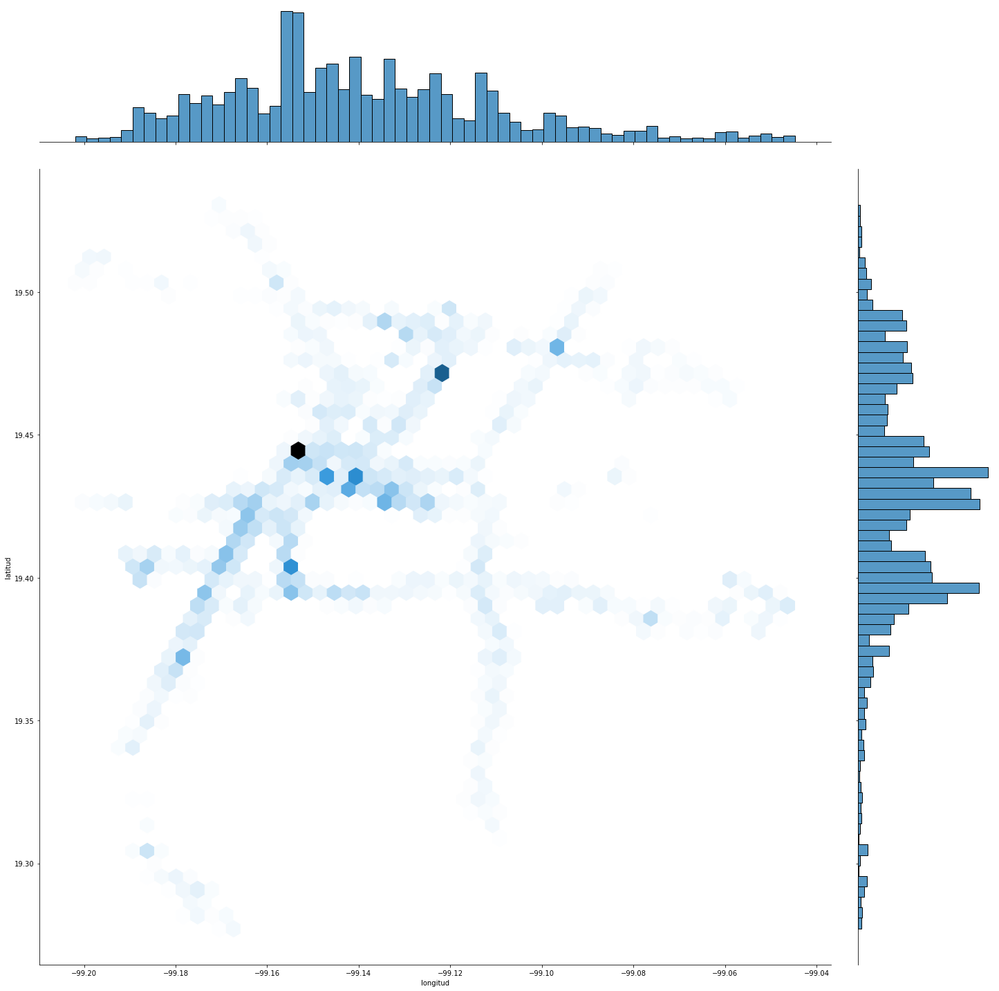

In [106]:
sns.jointplot(data=master_df, x='longitud', y='latitud', kind='hex', height=20 );